In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFBA'
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = False

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time

# Import the data using the old class
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [2325359]
dropping duplicated column
Hero ID used:  [2325359]
CPU times: user 134 ms, sys: 2.98 ms, total: 137 ms
Wall time: 137 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2325359,32,-1,3,-1.0,NaN,0.225067,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,74.147783,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 2,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,8,0,0,0,0.010417,30.0,50.239306,0.225067,74.147783,0.0,0.0,-1,0,1,0,0.0,4.306060,0.0,False,6.752009,2325359-30.0 mg/kg-gavage
1,2325359,32,-1,3,-1.0,NaN,0.225067,NaN,rat,sprague-dawley,30.0,mg/kg,0.50,hour,111.389163,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 2,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,8,0,0,0,0.020833,30.0,50.249722,0.225134,111.389163,0.0,0.0,-1,0,1,0,0.0,4.713030,0.0,False,6.752009,2325359-30.0 mg/kg-gavage
2,2325359,32,-1,3,-1.0,NaN,0.225067,NaN,rat,sprague-dawley,30.0,mg/kg,1.00,hour,136.098522,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 2,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,8,0,0,0,0.041667,30.0,50.270556,0.225268,136.098522,0.0,0.0,-1,0,1,0,0.0,4.913379,0.0,False,6.752009,2325359-30.0 mg/kg-gavage
3,2325359,32,-1,3,-1.0,NaN,0.225067,NaN,rat,sprague-dawley,30.0,mg/kg,2.00,hour,122.266010,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 2,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,8,0,0,0,0.083333,30.0,50.312222,0.225536,122.266010,0.0,0.0,-1,0,1,0,0.0,4.806199,0.0,False,6.752009,2325359-30.0 mg/kg-gavage
4,2325359,32,-1,3,-1.0,NaN,0.225067,NaN,rat,sprague-dawley,30.0,mg/kg,4.00,hour,118.482759,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 2,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,8,0,0,0,0.166667,30.0,50.395556,0.226071,118.482759,0.0,0.0,-1,0,1,0,0.0,4.774767,0.0,False,6.752009,2325359-30.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', hierarchy='multi',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Male_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-08-14 08:36:04.764782: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %reduce.3 = f64[4,5000,18]{2,1,0} reduce(f64[4,5000,1,18]{3,2,1,0} %broadcast.33, f64[] %constant.37), dimensions={2}, to_apply=%region_1.93, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmpgs1x2wwb" source_line=63}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-08-14 08:36:04.831298: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.06670207s
Constant folding an instruction is taking > 1s:

  %reduce.3 = f64[4,5000,18]{

Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


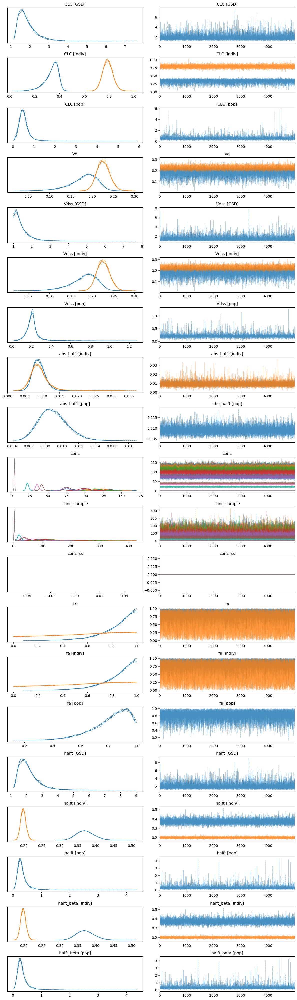

In [5]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


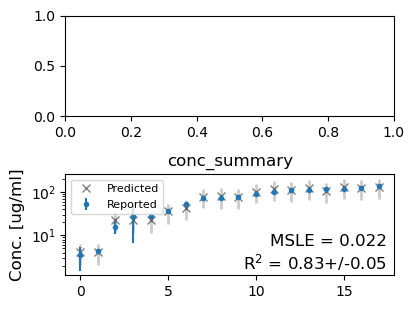

In [6]:
pfas_male_1cmpt.plot_data_ppc(group='posterior') 

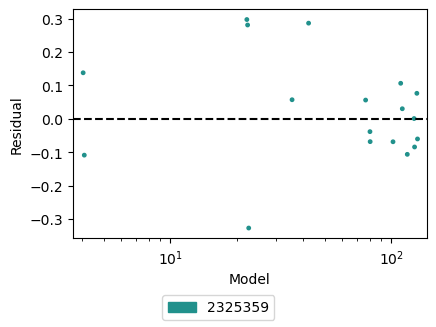

In [7]:
pfas_male_1cmpt.plot_residuals() 

#### 2-Compartment model

In [8]:
%%time
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', hierarchy='multi',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Male_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...
CPU times: user 5min 43s, sys: 53.8 s, total: 6min 37s
Wall time: 2min 21s


In [9]:
pfas_male_2cmpt.bayes_r2

r2        0.830350
r2_std    0.054128
dtype: float64

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


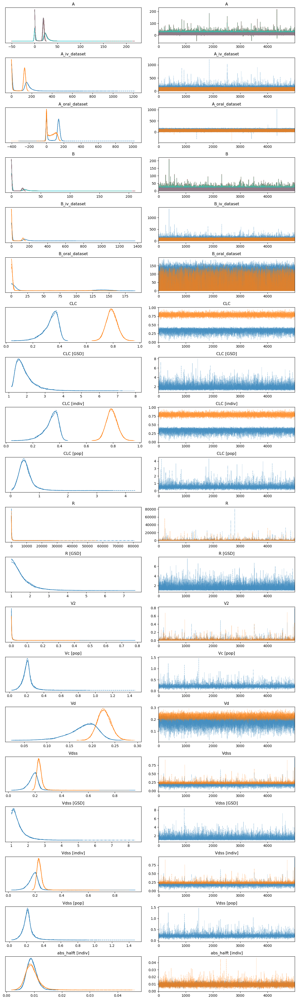

In [10]:
with pfas_male_2cmpt.model:
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


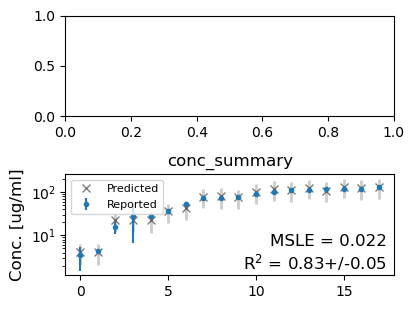

In [11]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-219.560190,11.535748,0.000000,1.000000e+00,10.248870,0.000000,True,log
1_compartment,1,-219.604864,11.619882,0.044674,4.440892e-16,10.229119,0.080644,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

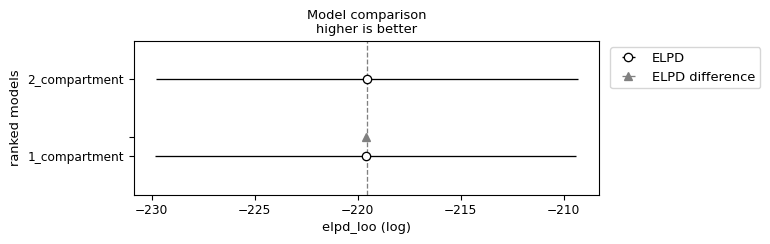

In [12]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [13]:
pfas_male = pfas_male_2cmpt 
print(pfas_male.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


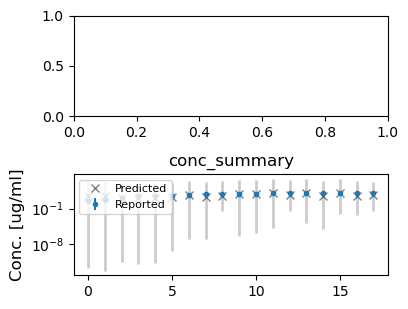

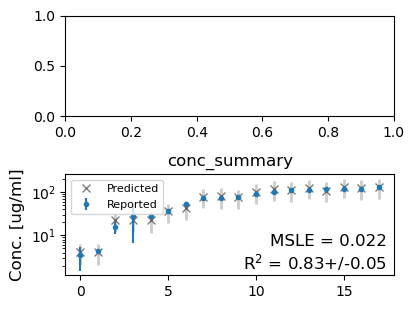

In [14]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

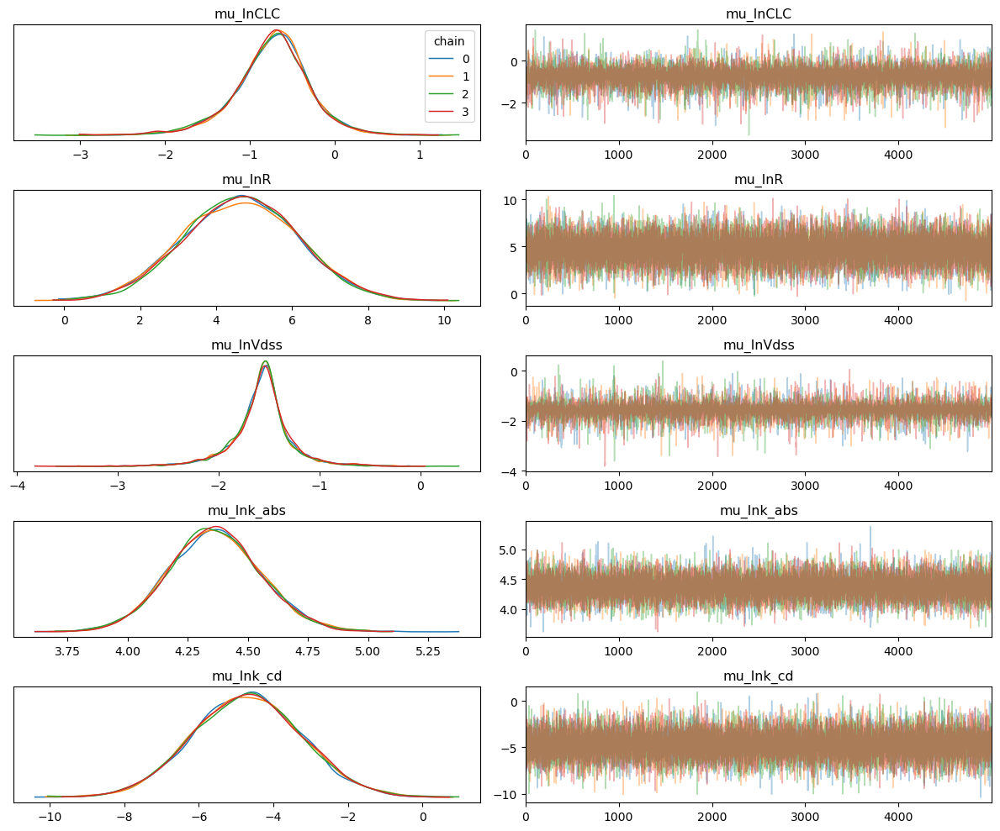

In [15]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFBA/PFBA_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


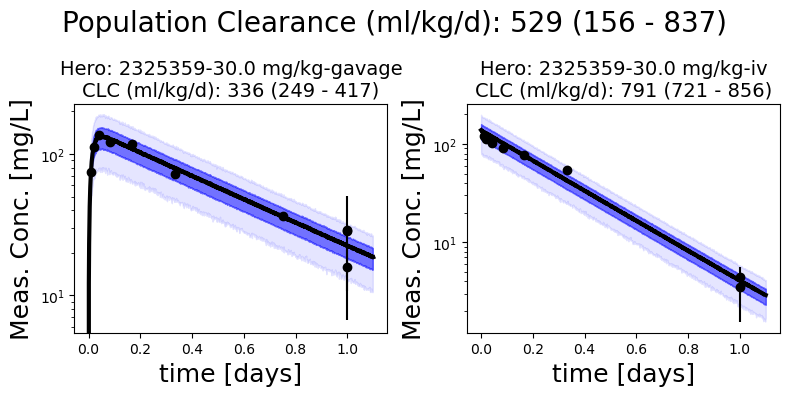

In [16]:
pfas_male.plot_all_studies()

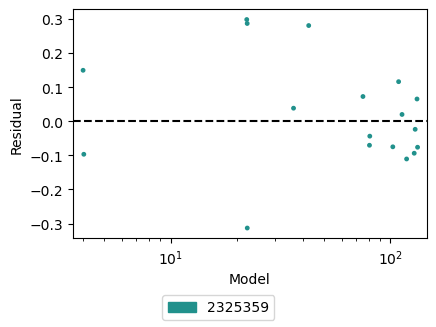

In [17]:
pfas_male.plot_residuals()

### PK stats

In [18]:
pfas_male.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.52866,0.25975,0.15606,0.83741
Vc [pop],0.21049,0.06796,0.10321,0.28789
Vdss [pop],0.21665,0.07172,0.10837,0.30255
abs_halft [pop],0.00899,0.00173,0.00614,0.01168
fa [pop],0.81536,0.13141,0.62939,0.99753
halft [pop],0.34781,0.23466,0.07826,0.58946
halft_alpha [pop],0.24899,0.19697,0.00024,0.44787
halft_beta [pop],6.47733,33.51924,0.03892,11.23570


## Female

In [19]:
%%time

# Import the data using the old class
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data.head()

Hero ID available:  [2325359]
dropping duplicated column
Hero ID used:  [2325359]
CPU times: user 131 ms, sys: 3.6 ms, total: 134 ms
Wall time: 134 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2325359,33,-1,3,-1.0,NaN,0.22501,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,138.011410,0.0,0,ug/ml,iv,serum,Female,DTXSID4059916,Figure 1,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.010417,30.0,77.610417,0.225010,138.011410,0.0,0.0,-1,0,0,1,0.0,4.927336,0.0,False,6.750313,2325359-30.0 mg/kg-iv
1,2325359,33,-1,3,-1.0,NaN,0.22501,NaN,rat,sprague-dawley,30.0,mg/kg,0.50,hour,112.954377,0.0,0,ug/ml,iv,serum,Female,DTXSID4059916,Figure 1,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.020833,30.0,77.620833,0.225021,112.954377,0.0,0.0,-1,0,0,1,0.0,4.726984,0.0,False,6.750313,2325359-30.0 mg/kg-iv
2,2325359,33,-1,3,-1.0,NaN,0.22501,NaN,rat,sprague-dawley,30.0,mg/kg,1.00,hour,83.243684,0.0,0,ug/ml,iv,serum,Female,DTXSID4059916,Figure 1,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.041667,30.0,77.641667,0.225042,83.243684,0.0,0.0,-1,0,0,1,0.0,4.421772,0.0,False,6.750313,2325359-30.0 mg/kg-iv
3,2325359,33,-1,3,-1.0,NaN,0.22501,NaN,rat,sprague-dawley,30.0,mg/kg,2.00,hour,42.950285,0.0,0,ug/ml,iv,serum,Female,DTXSID4059916,Figure 1,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.083333,30.0,77.683333,0.225083,42.950285,0.0,0.0,-1,0,0,1,0.0,3.760043,0.0,False,6.750313,2325359-30.0 mg/kg-iv
4,2325359,33,-1,3,-1.0,NaN,0.22501,NaN,rat,sprague-dawley,30.0,mg/kg,4.00,hour,11.263244,0.0,0,ug/ml,iv,serum,Female,DTXSID4059916,Figure 1,9.0,weeks,225.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.166667,30.0,77.766667,0.225167,11.263244,0.0,0.0,-1,0,0,1,0.0,2.421545,0.0,False,6.750313,2325359-30.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [20]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', hierarchy='multi',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Female_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


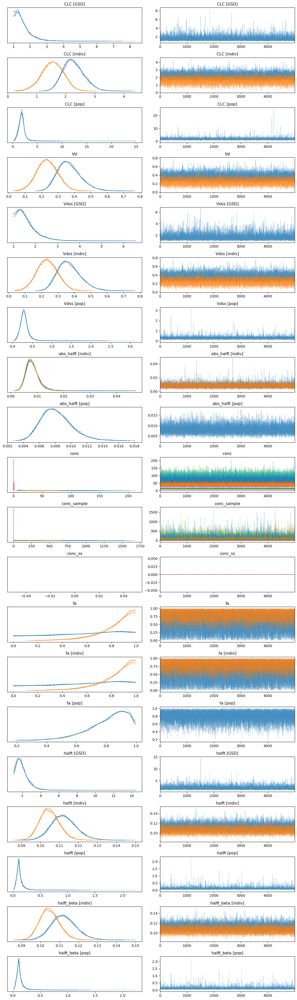

In [21]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


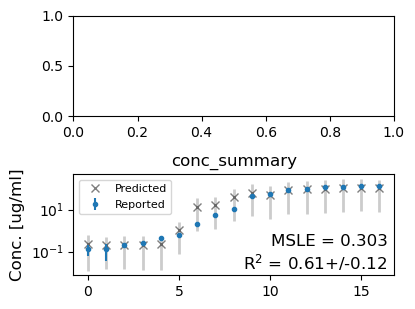

In [22]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [23]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', hierarchy='multi', 
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Female_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


In [24]:
pfas_female_2cmpt.bayes_r2 # hierarchical

r2        0.815788
r2_std    0.072922
dtype: float64

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


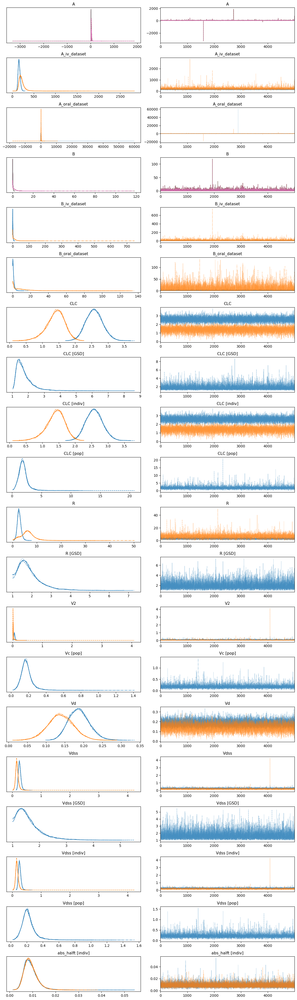

In [25]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


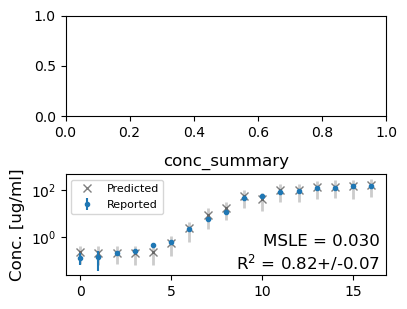

In [26]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-139.936521,25.500166,0.000000,0.769497,27.093332,0.000000,True,log
1_compartment,1,-159.618692,13.618666,19.682171,0.230503,32.623215,15.060927,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

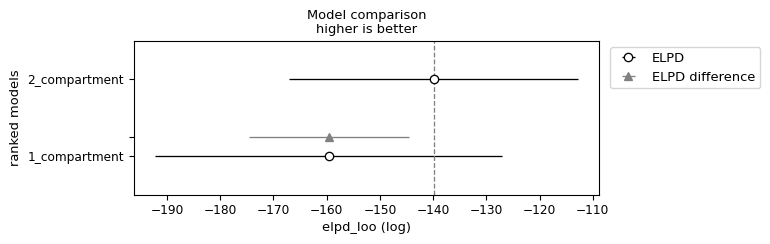

In [27]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [28]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


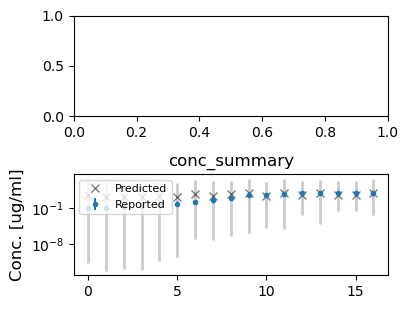

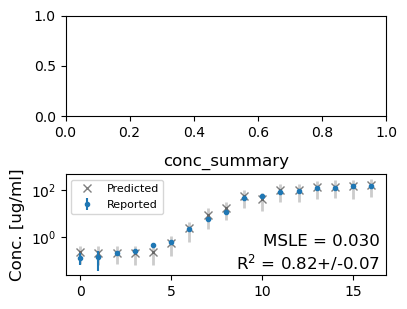

In [29]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

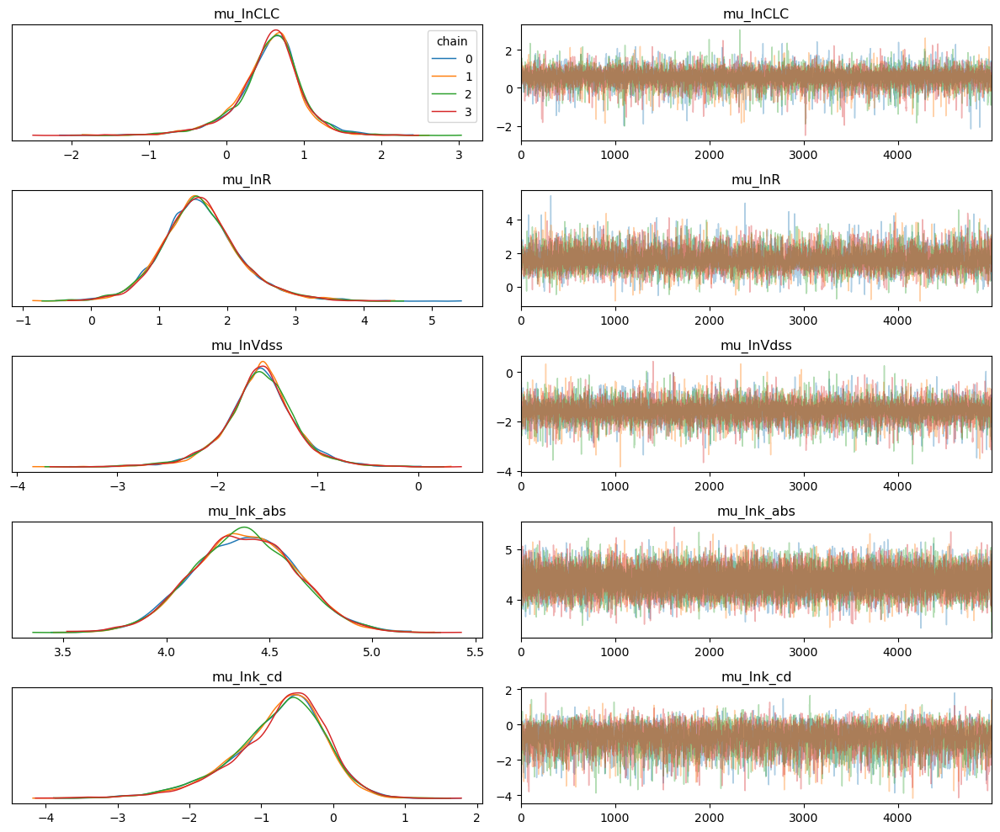

In [30]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFBA/PFBA_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


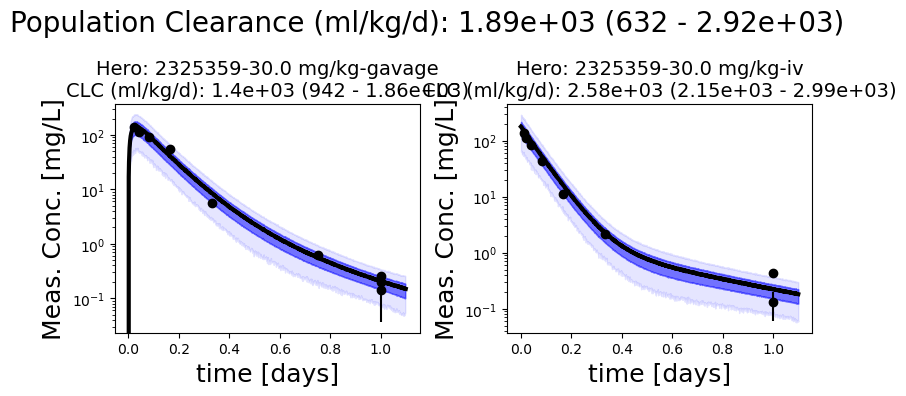

In [31]:
pfas_female.plot_all_studies() 

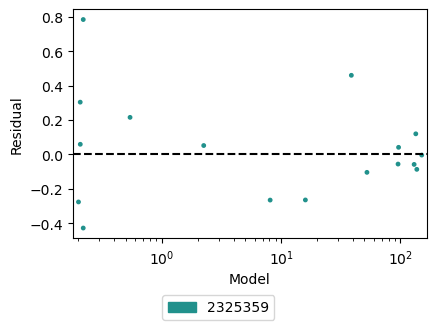

In [32]:
pfas_female.plot_residuals()

### PK stats

In [33]:
pfas_female.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],1.88879,0.84846,0.63159,2.92436
Vc [pop],0.18011,0.07255,0.07596,0.27248
Vdss [pop],0.22140,0.08976,0.09252,0.33599
abs_halft [pop],0.00896,0.00226,0.00543,0.01249
fa [pop],0.81417,0.13054,0.62808,0.99745
halft [pop],0.09792,0.07532,0.02058,0.16772
halft_alpha [pop],0.06671,0.03564,0.01951,0.11117
halft_beta [pop],0.50127,0.67831,0.04902,1.06637


# Mouse

## Male

In [34]:
%%time

# Import the data using the old class
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [2325359]
dropping duplicated column
Hero ID used:  [2325359]
CPU times: user 71 ms, sys: 3.13 ms, total: 74.1 ms
Wall time: 73 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2325359,34,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,1.0,hour,51.432982,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 3,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,6,0,0,0,0.041667,10.0,0.03,51.432982,0.0,0.0,-1,0,1,0,0.0,3.940280,0.0,False,0.3,2325359-10.0 mg/kg-gavage
1,2325359,34,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,4.0,hour,45.504397,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 3,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,6,0,0,0,0.166667,10.0,0.03,45.504397,0.0,0.0,-1,0,1,0,0.0,3.817809,0.0,False,0.3,2325359-10.0 mg/kg-gavage
2,2325359,34,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,8.0,hour,28.163390,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 3,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,6,0,0,0,0.333333,10.0,0.03,28.163390,0.0,0.0,-1,0,1,0,0.0,3.338023,0.0,False,0.3,2325359-10.0 mg/kg-gavage
3,2325359,34,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,12.0,hour,39.129417,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 3,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,6,0,0,0,0.500000,10.0,0.03,39.129417,0.0,0.0,-1,0,1,0,0.0,3.666875,0.0,False,0.3,2325359-10.0 mg/kg-gavage
4,2325359,34,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,24.0,hour,12.321467,0.0,0,ug/ml,gavage,serum,Male,DTXSID4059916,Figure 3,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,6,0,0,0,1.000000,10.0,0.03,12.321467,0.0,0.0,-1,0,1,0,0.0,2.511343,0.0,False,0.3,2325359-10.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [35]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Male_mouse_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


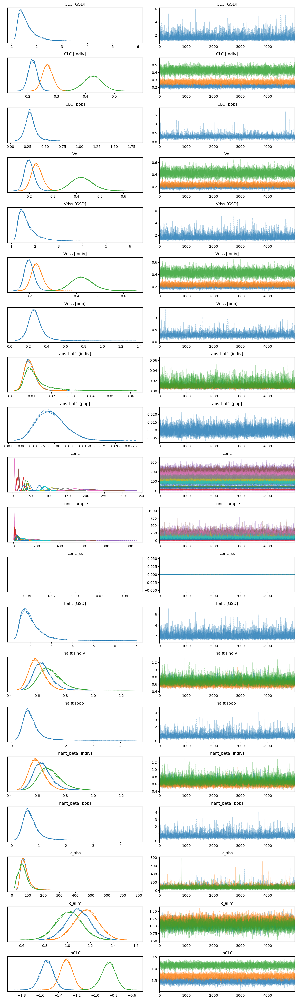

In [36]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


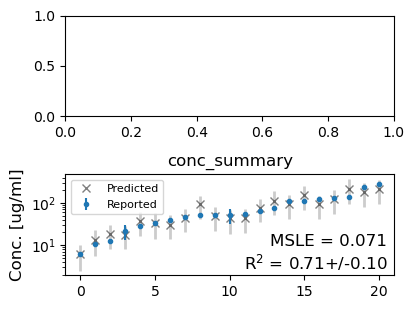

In [37]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [38]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Male_mouse_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


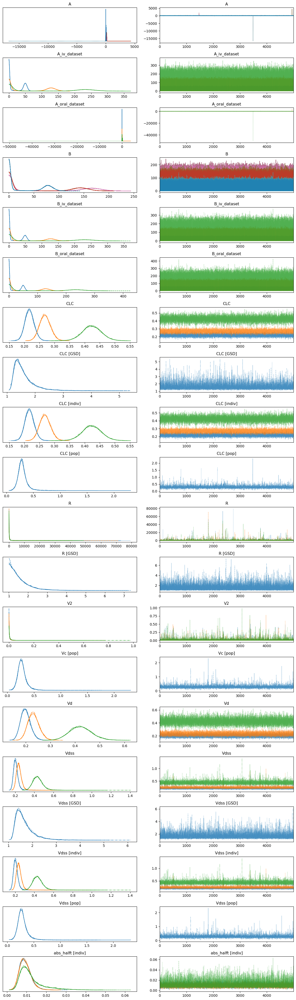

In [39]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


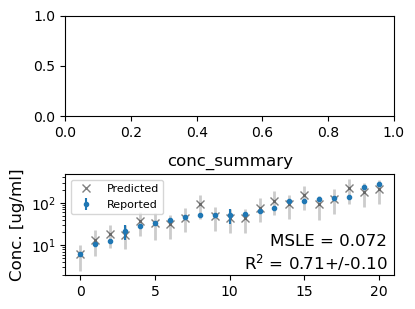

In [40]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-274.114335,16.600394,0.000000,1.0,16.028379,0.000000,True,log
1_compartment,1,-274.630981,17.192440,0.516646,0.0,15.930467,0.366488,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

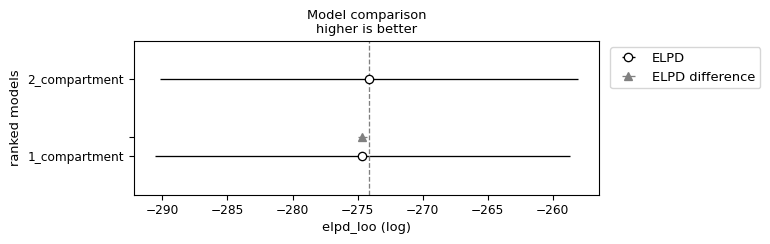

In [41]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [93]:
pfas_male_mouse = pfas_male_2cmpt_mouse
print(pfas_male_mouse.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


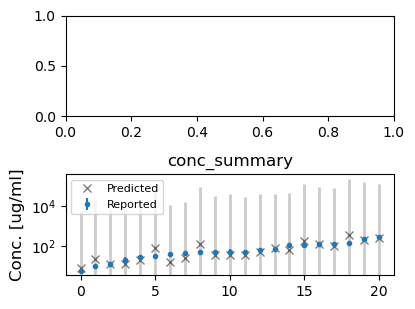

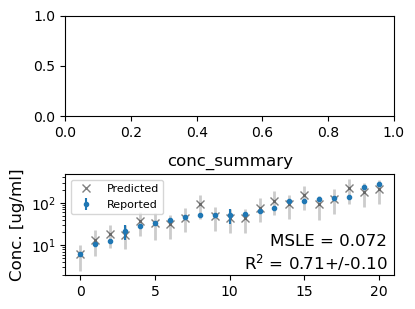

In [94]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

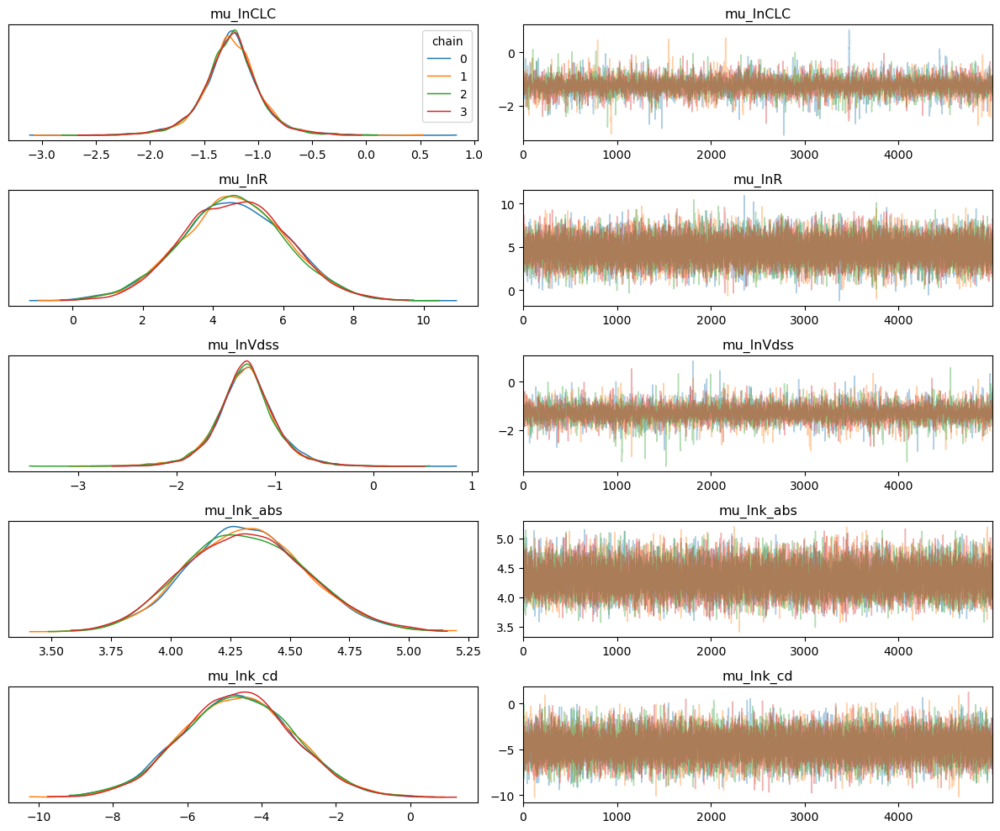

In [95]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFBA/PFBA_Male_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


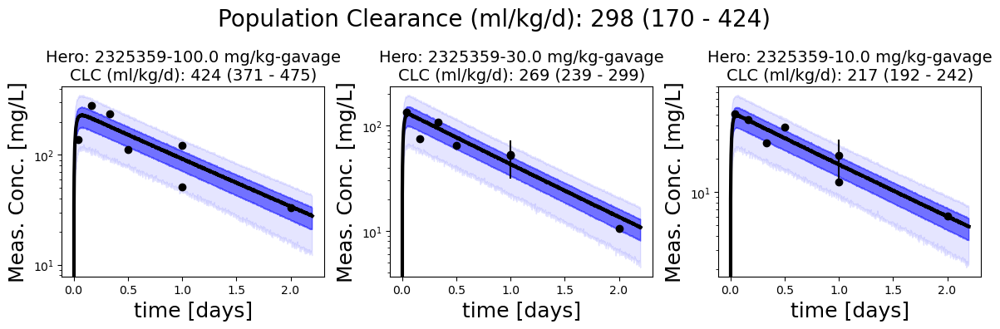

In [96]:
pfas_male_mouse.plot_all_studies()

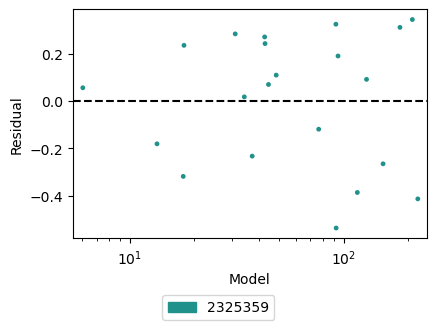

In [97]:
pfas_male_mouse.plot_residuals()

### PK stats

In [98]:
pfas_male_mouse.get_pk_stats(level='GSD')

,mean,sd,hdi_5%,hdi_95%
CLC [GSD],1.59806,0.38625,1.14924,2.08138
R [GSD],1.56160,0.55633,1.00000,2.25310
Vdss [GSD],1.67369,0.41737,1.16020,2.19188
halft [GSD],2.76050,0.89266,1.54487,3.98916
k_cd [GSD],1.57219,0.56952,1.00005,2.28438


In [99]:
pfas_male_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.29821,0.09229,0.17004,0.42385
Vc [pop],0.27961,0.09681,0.14925,0.41091
Vdss [pop],0.28805,0.10150,0.14806,0.42088
abs_halft [pop],0.00952,0.00239,0.00552,0.01313
halft [pop],0.72392,0.34047,0.26865,1.15683
halft_alpha [pop],0.44833,0.33109,0.00057,0.85263
halft_beta [pop],6.37666,34.10104,0.12752,11.13841


## Female

In [49]:
%%time

# Import the data using the old class
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [2325359]
dropping duplicated column
Hero ID used:  [2325359]
CPU times: user 68.8 ms, sys: 3.1 ms, total: 71.9 ms
Wall time: 71.2 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2325359,35,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,1.0,hour,40.399775,0.0,0,ug/ml,gavage,serum,Female,DTXSID4059916,Figure 4,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,5,0,0,0,0.041667,10.0,0.03,40.399775,0.0,0.0,-1,0,1,1,0.0,3.698824,0.0,False,0.3,2325359-10.0 mg/kg-gavage
1,2325359,35,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,4.0,hour,46.061710,0.0,0,ug/ml,gavage,serum,Female,DTXSID4059916,Figure 4,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,5,0,0,0,0.166667,10.0,0.03,46.061710,0.0,0.0,-1,0,1,1,0.0,3.829982,0.0,False,0.3,2325359-10.0 mg/kg-gavage
2,2325359,35,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,8.0,hour,21.334741,0.0,0,ug/ml,gavage,serum,Female,DTXSID4059916,Figure 4,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,5,0,0,0,0.333333,10.0,0.03,21.334741,0.0,0.0,-1,0,1,1,0.0,3.060337,0.0,False,0.3,2325359-10.0 mg/kg-gavage
3,2325359,35,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,12.0,hour,7.549606,0.0,0,ug/ml,gavage,serum,Female,DTXSID4059916,Figure 4,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,5,0,0,0,0.500000,10.0,0.03,7.549606,0.0,0.0,-1,0,1,1,0.0,2.021495,0.0,False,0.3,2325359-10.0 mg/kg-gavage
4,2325359,35,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,10.0,mg/kg,24.0,hour,0.929890,0.0,0,ug/ml,gavage,serum,Female,DTXSID4059916,Figure 4,9.0,weeks,30.0,grams,3,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,5,0,0,0,1.000000,10.0,0.03,0.929890,0.0,0.0,-1,0,1,1,0.0,-0.072689,0.0,False,0.3,2325359-10.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [50]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=15000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Female_mouse_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


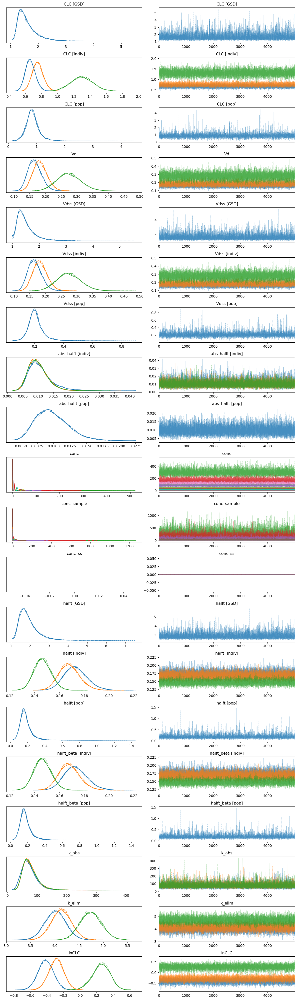

In [51]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


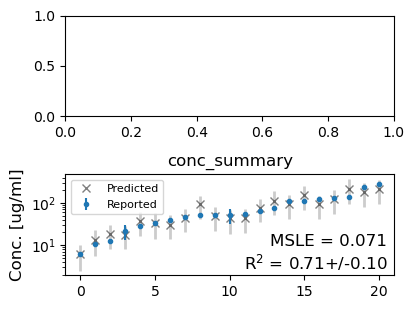

In [52]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [53]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=15000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Female_mouse_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


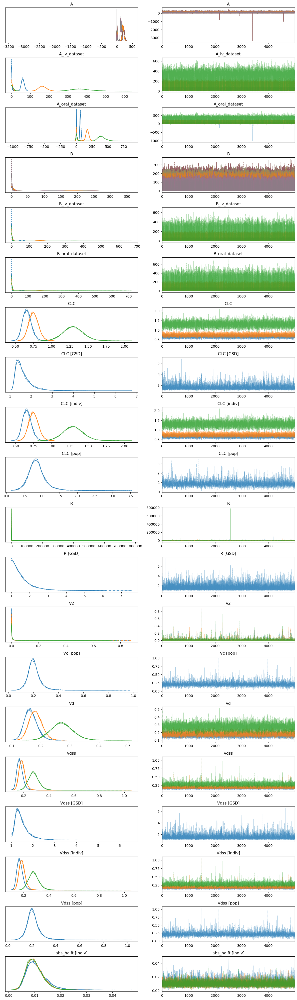

In [54]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


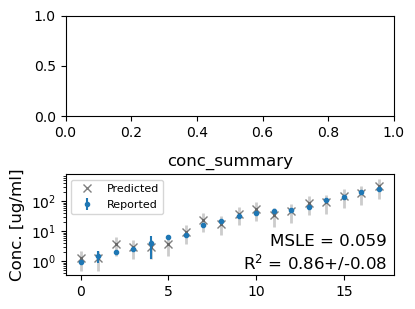

In [55]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-188.243848,20.721417,0.000000,0.519276,19.653048,0.000000,True,log
1_compartment,1,-188.249625,20.574221,0.005777,0.480724,19.750133,0.669505,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

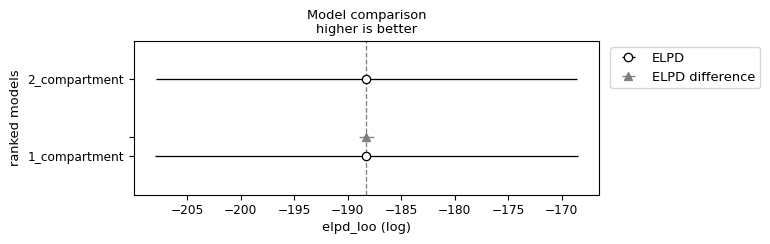

In [56]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [100]:
pfas_female_mouse = pfas_female_2cmpt_mouse
print(pfas_female_mouse.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


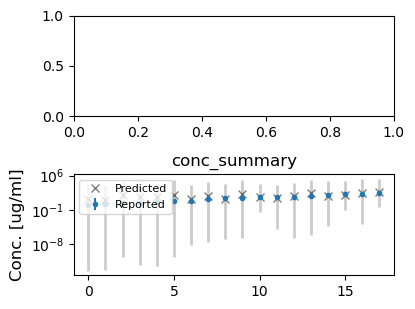

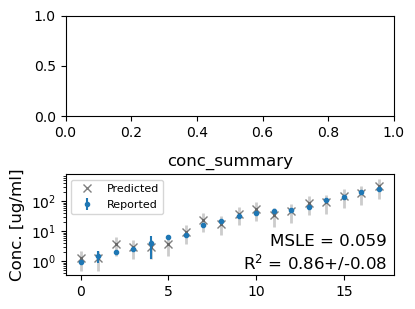

In [101]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

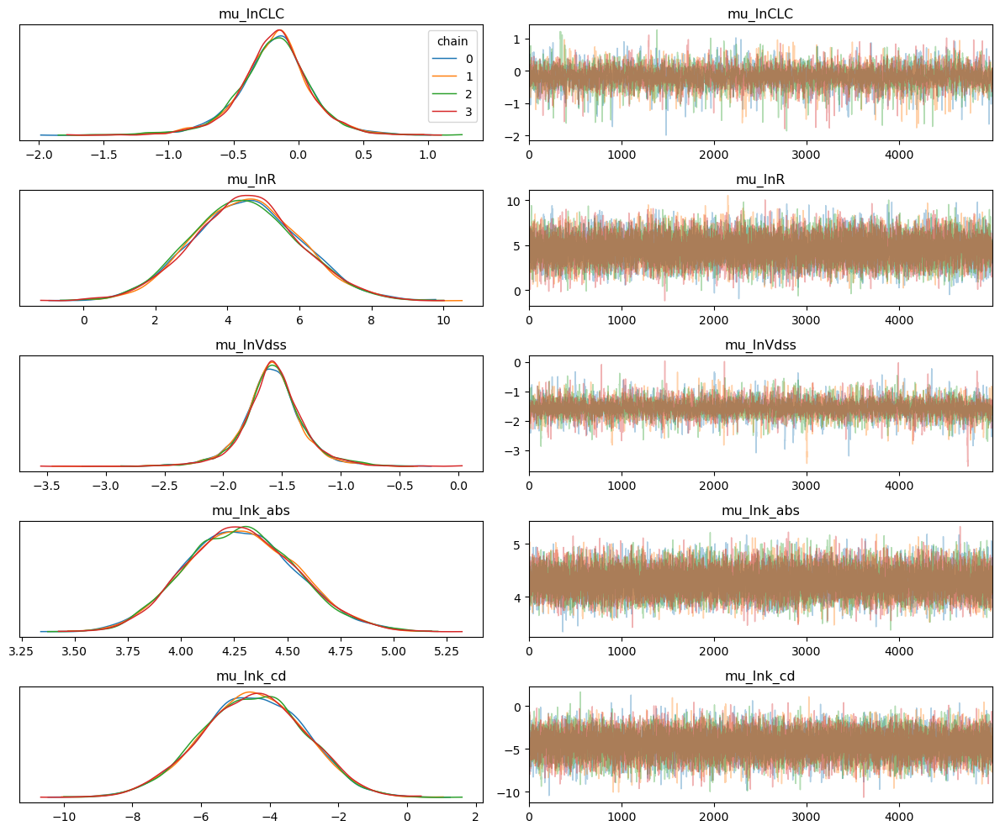

In [102]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFBA/PFBA_Female_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


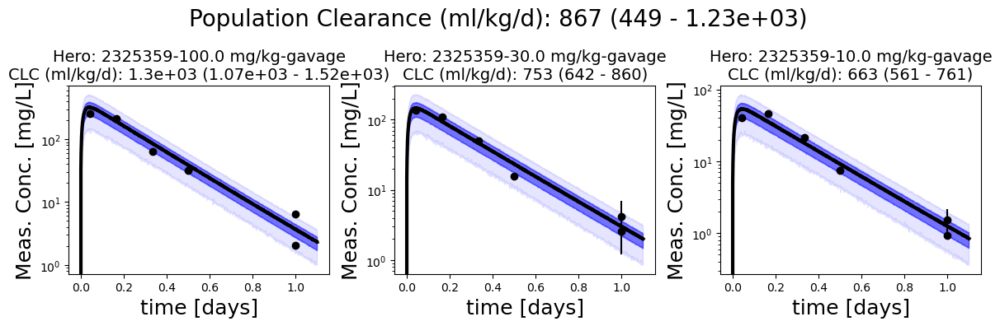

In [103]:
pfas_female_mouse.plot_all_studies()

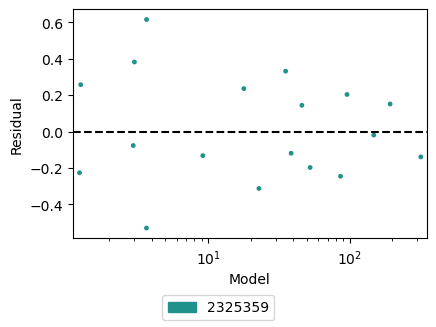

In [104]:
pfas_female_mouse.plot_residuals()

### PK stats

In [105]:
pfas_female_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.86664,0.26085,0.44880,1.22827
Vc [pop],0.20752,0.05707,0.12431,0.29096
Vdss [pop],0.21407,0.06115,0.12350,0.29850
abs_halft [pop],0.00987,0.00254,0.00571,0.01378
halft [pop],0.18614,0.08127,0.07340,0.28823
halft_alpha [pop],0.14976,0.08051,0.00184,0.23920
halft_beta [pop],5.70190,31.51636,0.04300,9.49234


# Primate

## Male

In [5]:
%%time

# Import the data using the old class
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()

Hero ID available:  [2325359]
dropping duplicated column
Hero ID used:  [2325359]
CPU times: user 67.2 ms, sys: 2.93 ms, total: 70.2 ms
Wall time: 68.8 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2325359,36,1,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,0.0,hour,33700.64329,0.0,0,ng/ml,iv,serum,Male,DTXSID4059916,Figure 5,2.75,years,5.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.000000,10.0,5.0,33.700643,0.0,0.0,-1,0,0,0,0.0,3.517517,0.0,True,50.0,2325359-10.0 mg/kg-iv
1,2325359,36,2,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,0.0,hour,31211.26827,0.0,0,ng/ml,iv,serum,Male,DTXSID4059916,Figure 5,2.75,years,5.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.000000,10.0,5.0,31.211268,0.0,0.0,-1,0,0,0,0.0,3.440779,0.0,True,50.0,2325359-10.0 mg/kg-iv
2,2325359,36,3,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,0.0,hour,41757.06271,0.0,0,ng/ml,iv,serum,Male,DTXSID4059916,Figure 5,2.75,years,5.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.000000,10.0,5.0,41.757063,0.0,0.0,-1,0,0,0,0.0,3.731869,0.0,True,50.0,2325359-10.0 mg/kg-iv
3,2325359,36,1,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,18464.24943,0.0,0,ng/ml,iv,serum,Male,DTXSID4059916,Figure 5,2.75,years,5.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.083333,10.0,5.0,18.464249,0.0,0.0,-1,0,0,0,0.0,2.915836,0.0,True,50.0,2325359-10.0 mg/kg-iv
4,2325359,36,2,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,16641.78549,0.0,0,ng/ml,iv,serum,Male,DTXSID4059916,Figure 5,2.75,years,5.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.083333,10.0,5.0,16.641785,0.0,0.0,-1,0,0,0,0.0,2.811917,0.0,True,50.0,2325359-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [64]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Male_primate_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


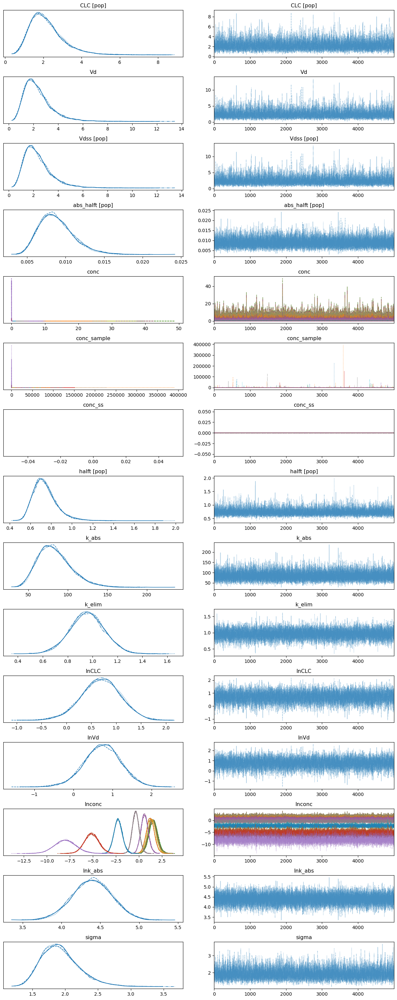

In [65]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


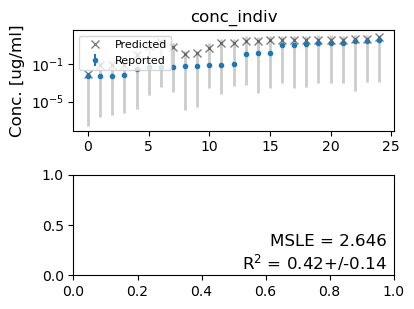

In [66]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [67]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Male_primate_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


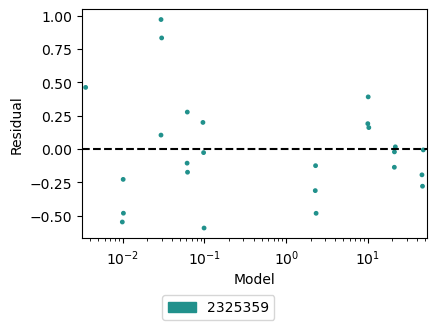

In [68]:
pfas_male_2cmpt_primate.plot_residuals() # Lognormal

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


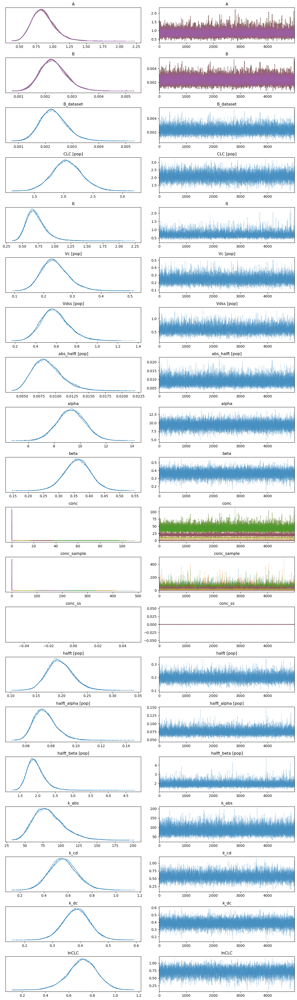

In [69]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


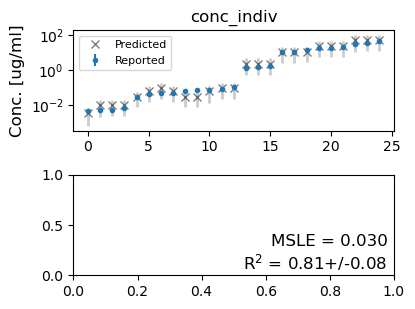

In [70]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,1.316948,4.400724,0.000000,1.000000e+00,14.743156,0.000000,False,log
1_compartment,1,-35.212754,2.459883,36.529702,4.845901e-12,15.292959,4.871354,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

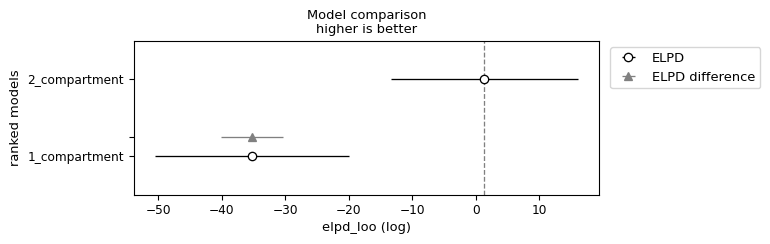

In [71]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [72]:
pfas_male_primate = pfas_male_2cmpt_primate
print(pfas_male_primate.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


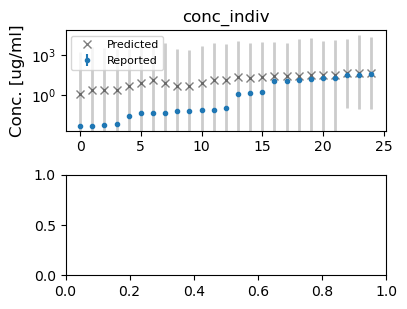

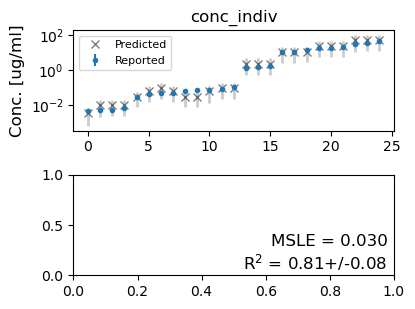

In [73]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

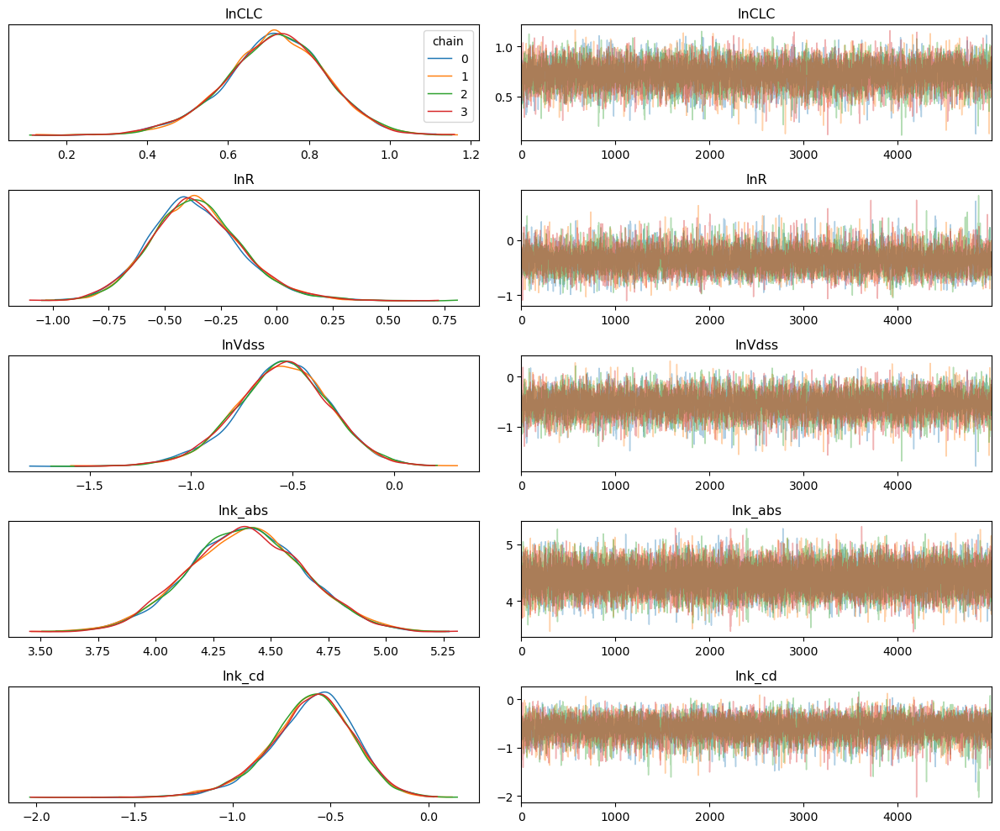

In [74]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFBA/PFBA_Male_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


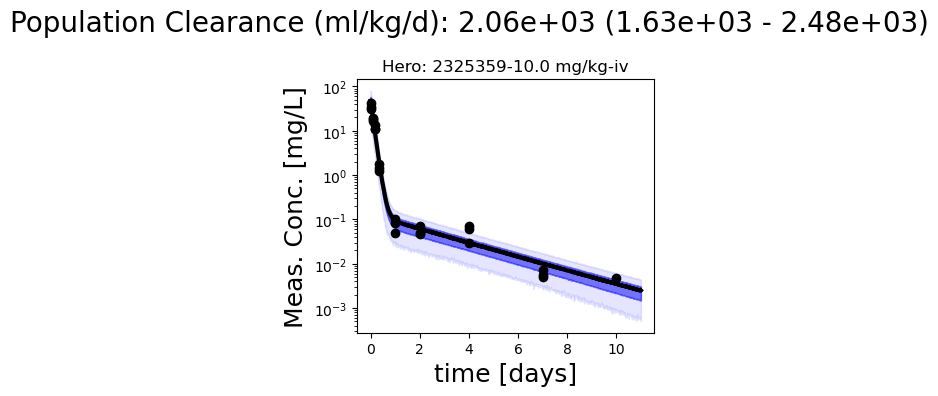

In [75]:
pfas_male_primate.plot_all_studies()

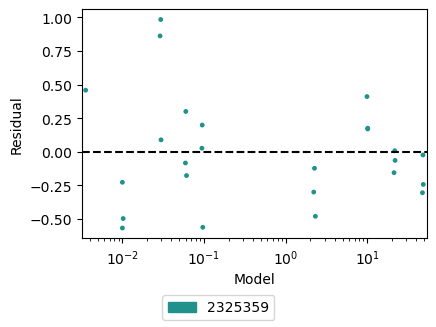

In [76]:
pfas_male_primate.plot_residuals()

### PK stats

In [77]:
pfas_male_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],2.06103,0.25977,1.62578,2.47975
Vc [pop],0.24076,0.04854,0.16156,0.31605
Vdss [pop],0.59223,0.13796,0.36132,0.80394
abs_halft [pop],0.00883,0.00224,0.00512,0.01217
halft [pop],0.19707,0.02571,0.15341,0.23613
halft_alpha [pop],0.07550,0.00915,0.06120,0.09004
halft_beta [pop],1.94658,0.24843,1.54593,2.30596


## Female

In [3]:
%%time

# Import the data using the old class
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate.head()

Hero ID available:  [2325359]
dropping duplicated column
Hero ID used:  [2325359]
CPU times: user 72.2 ms, sys: 0 ns, total: 72.2 ms
Wall time: 71.3 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2325359,37,4,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,0.0,hour,38293.00127,0.0,0,ng/ml,iv,serum,Female,DTXSID4059916,Figure 5,2.75,years,4.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.000000,10.0,4.0,38.293001,0.0,0.0,-1,0,0,1,0.0,3.645267,0.0,True,40.0,2325359-10.0 mg/kg-iv
1,2325359,37,5,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,0.0,hour,41062.49917,0.0,0,ng/ml,iv,serum,Female,DTXSID4059916,Figure 5,2.75,years,4.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.000000,10.0,4.0,41.062499,0.0,0.0,-1,0,0,1,0.0,3.715095,0.0,True,40.0,2325359-10.0 mg/kg-iv
2,2325359,37,6,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,0.0,hour,34145.48874,0.0,0,ng/ml,iv,serum,Female,DTXSID4059916,Figure 5,2.75,years,4.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.000000,10.0,4.0,34.145489,0.0,0.0,-1,0,0,1,0.0,3.530630,0.0,True,40.0,2325359-10.0 mg/kg-iv
3,2325359,37,4,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,21782.68580,0.0,0,ng/ml,iv,serum,Female,DTXSID4059916,Figure 5,2.75,years,4.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.083333,10.0,4.0,21.782686,0.0,0.0,-1,0,0,1,0.0,3.081115,0.0,True,40.0,2325359-10.0 mg/kg-iv
4,2325359,37,5,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,28985.77215,0.0,0,ng/ml,iv,serum,Female,DTXSID4059916,Figure 5,2.75,years,4.0,kilograms,1,Chang,Perfluorobutanoic acid,PFBA,375-22-4,"2,2,3,3,4,4,4-heptafluorobutanoic acid",DTXSID4059916,7,0,0,0,0.083333,10.0,4.0,28.985772,0.0,0.0,-1,0,0,1,0.0,3.366805,0.0,True,40.0,2325359-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [5]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Female_primate_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-10-10 10:30:05.451641: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,26]{2,1,0} reduce(f64[4,5000,1,26]{3,2,1,0} %broadcast.14, f64[] %constant.17), dimensions={2}, to_apply=%region_0.39, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmp_465l737" source_line=23}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-10-10 10:30:05.699797: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.248294962s
Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,26]{2,1

Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


In [6]:
pfas_female_1cmpt_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
halft [pop],0.84787,0.11789,0.66576,1.02449
Vdss [pop],1.89648,0.90791,0.60498,3.17288
CLC [pop],1.52063,0.60891,0.61134,2.40677
abs_halft [pop],0.00881,0.00223,0.00524,0.01224


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


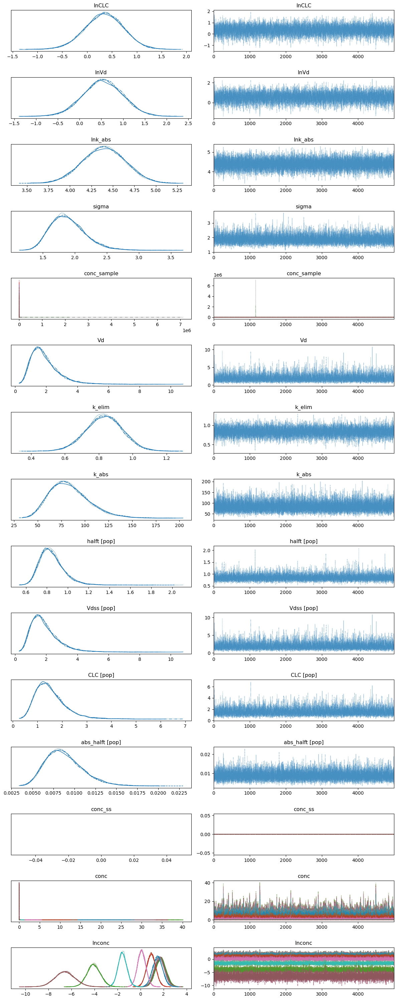

In [7]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


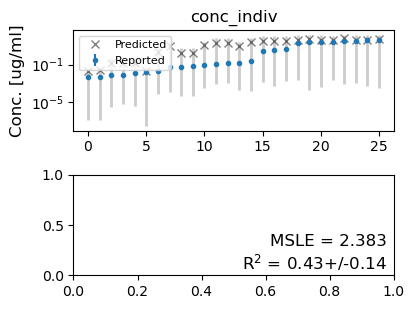

In [8]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [9]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBA_Female_primate_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:795: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(


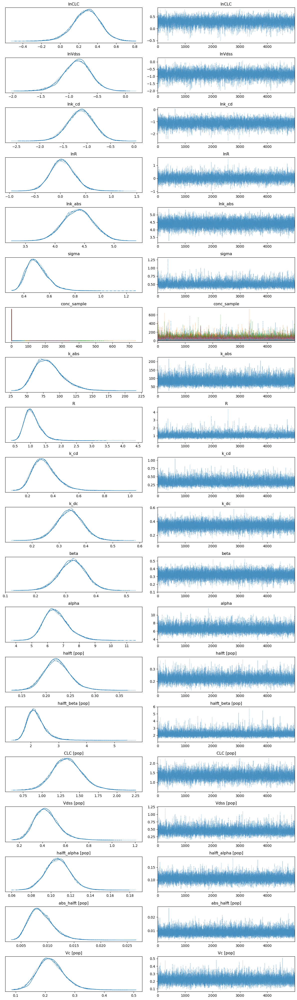

In [10]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


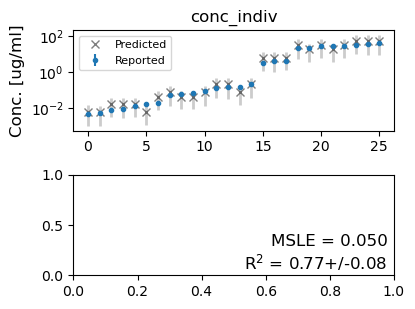

In [11]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:795: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-1.662639,4.933071,0.000000,1.000000e+00,15.927464,0.000000,True,log
1_compartment,1,-34.732925,2.032883,33.070286,4.050094e-13,16.524200,4.342327,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

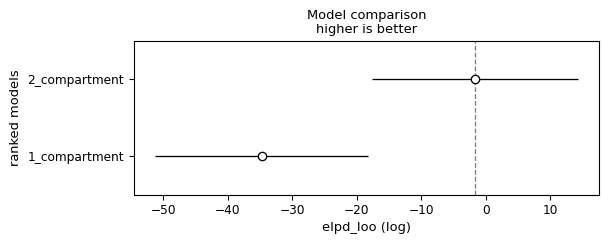

In [13]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_female_primate_compare, insample_dev=False)

#### Define winning model

In [16]:
pfas_female_primate = pfas_female_2cmpt_primate
print(pfas_female_primate.N_divergences)
print('Pass all metrics: ', pfas_female_primate.pass_all_metrics)

0
Pass all metrics:  True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


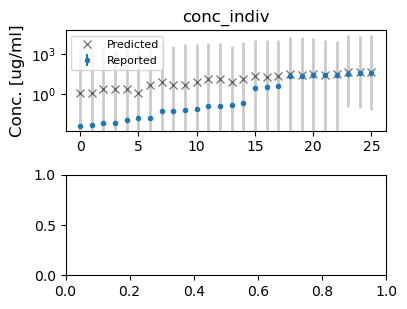

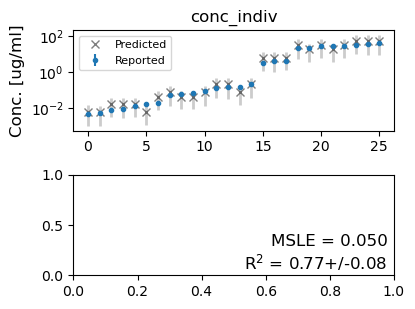

In [17]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

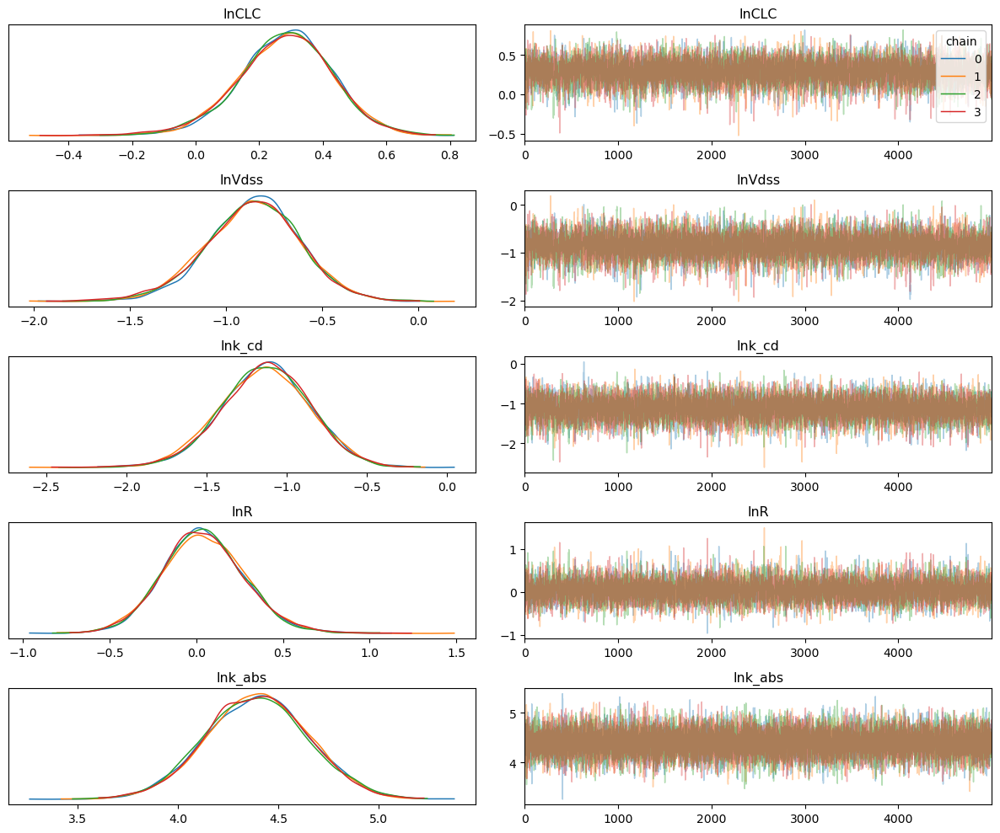

In [18]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFBA/PFBA_Female_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


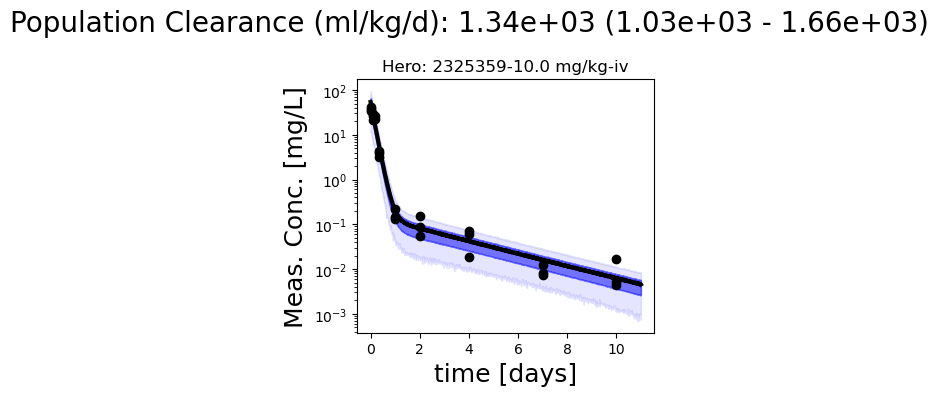

In [19]:
pfas_female_primate.plot_all_studies()

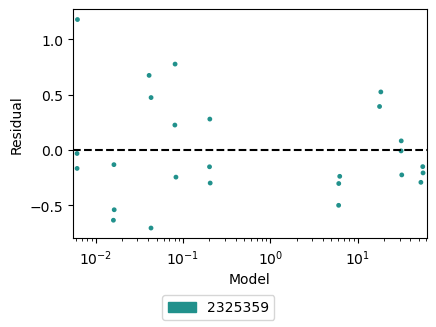

In [20]:
pfas_female_primate.plot_residuals()

### PK stats

In [21]:
pfas_female_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
halft [pop],0.22309,0.02766,0.17921,0.26744
halft_beta [pop],2.20326,0.33689,1.68794,2.68742
CLC [pop],1.34117,0.19679,1.02627,1.66445
Vdss [pop],0.43685,0.10854,0.25819,0.59952
halft_alpha [pop],0.10708,0.01279,0.08601,0.12760
abs_halft [pop],0.00884,0.00228,0.00508,0.01218
Vc [pop],0.21969,0.04579,0.14648,0.29300
